In [56]:
%load_ext autoreload
%autoreload 2
import os
# Set environment variables
os.environ["XLA_PYTHON_CLIENT_MEM_FRACTION"] = ".99"
os.environ["CUDA_VISIBLE_DEVICES"] = "1"
import jax
# from jax import config
# config.update('jax_enable_x64', True)

# Check JAX configuration
devices = jax.local_devices()
print(devices)
print(jax.default_backend())
print(jax.devices())

import sys
# Add custom path
sys.path.append("/pchem-data/meuwly/boittier/home/pycharmm_test/src")

# from model import EF
# from loss import dipole_calc
# from  training import train_model # from model import dipole_calc
import jax
import optax
import e3x

# from dcmnet.analysis import create_model_and_params
# from data import prepare_batches, prepare_datasets
import numpy as np

from physnetjax.model import EF
from physnetjax.loss import dipole_calc
from  physnetjax.training import train_model # from model import dipole_calc
from physnetjax.data import prepare_batches, prepare_datasets


import orbax
from orbax.checkpoint import PyTreeCheckpointer
orbax_checkpointer = orbax.checkpoint.PyTreeCheckpointer()

import jax
import jax.numpy as jnp
import flax.linen as nn
import networkx as nx
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2
import os
# Set environment variables
os.environ["XLA_PYTHON_CLIENT_MEM_FRACTION"] = ".99"
os.environ["CUDA_VISIBLE_DEVICES"] = "1"
import jax
# from jax import config
# config.update('jax_enable_x64', True)

# Check JAX configuration
devices = jax.local_devices()
print(devices)
print(jax.default_backend())
print(jax.devices())

import sys
# Add custom path
sys.path.append("/pchem-data/meuwly/boittier/home/pycharmm_test/src")

# from model import EF
# from loss import dipole_calc
# from  training import train_model # from model import dipole_calc
import jax
import optax
import e3x

# from dcmnet.analysis import create_model_and_params
# from data import prepare_batches, prepare_datasets
import numpy as np

from physnetjax.model import EF
from physnetjax.loss import dipole_calc
from  physnetjax.training import train_model # from model import dipole_calc
from physnetjax.data import prepare_batches, prepare_datasets


import orbax
from orbax.checkpoint import PyTreeCheckpointer
orbax_checkpointer = orbax.checkpoint.PyTreeCheckpointer()

from physnetjax.analysis import *

import polars as pl
from tensorboard.backend.event_processing.event_accumulator import EventAccumulator

from tensorflow.python.summary.summary_iterator import summary_iterator



import struct

def read_tensor(value):
    # Assuming the content is a single 32-bit float
    binary_content = value.tensor.tensor_content
    try:
        float_value = struct.unpack('f', binary_content)[0]  # 'f' is for 32-bit float
        # print(f"Decoded float value: {float_value}")
        return value.tag, float_value
    except struct.error:
        # print("Unable to decode binary content as float.")
         return value.tag, 0
    


def tensorboard_to_polars(logdir, i = 0):
    # Read the log file
    data = {}
    for event in summary_iterator(str(logdir)):
        for value in event.summary.value:
            k,v=read_tensor(value)
            data[k] = v
    data["epoch"] = i
    data["log"] = str(logdir)
    if data:
        df = pl.DataFrame(data)
        return df
    else:
        print("No scalar data found in the logdir.")
        return pl.DataFrame()

from pathlib import Path

restart_dir_base = Path("/pchem-data/meuwly/boittier/home/pycharmm_test/ckpts")
# Specify the log directory path
path = restart_dir_base / "test-4ae608b9-b9f8-42e6-9292-4ff3841b9962/tfevents" 
files = list(path.glob("*"))
print(files[0])
# Path to the TensorBoard log file
log_file = str(files[0])

# Convert TensorBoard logs to a Polars DataFrame
base_df = pl.concat([tensorboard_to_polars(str(_),i=i) for i, _ in enumerate(files) ])

# Display the first few rows
print(base_df.head())
print(base_df.columns)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
[CudaDevice(id=0)]
gpu
[CudaDevice(id=0)]
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
[CudaDevice(id=0)]
gpu
[CudaDevice(id=0)]
/pchem-data/meuwly/boittier/home/pycharmm_test/ckpts/test-4ae608b9-b9f8-42e6-9292-4ff3841b9962/tfevents/events.out.tfevents.1733413995.gpu25.542797.0.v2
shape: (5, 14)
┌────────────┬────────────┬────────────┬────────────┬───┬───────────┬──────────┬───────┬───────────┐
│ valid_ener ┆ valid_forc ┆ train_ener ┆ train_forc ┆ … ┆ dipole_w  ┆ forces_w ┆ epoch ┆ log       │
│ gy_mae     ┆ es_mae     ┆ gy_mae     ┆ es_mae     ┆   ┆ ---       ┆ ---      ┆ ---   ┆ ---       │
│ ---        ┆ ---        ┆ ---        ┆ ---        ┆   ┆ f64       ┆ f64      ┆ i64   ┆ str       │
│ f64        ┆ f64        ┆ f64        ┆ f64        ┆   ┆           ┆          ┆       ┆           │
╞════════════╪════════════╪════════════╪════════════╪═══╪══════════

In [87]:
# base_df["log"][0] #.apply(lambda x: 0)
# base_df.with_columns(
#     pl.col("log")
#     .map_elements(lambda x: pl.datetime(year=2024,
#                                         month=12,
#                                         day=5,
#         hour=int(x.split(".")[-5][:2]),
#                                        minute=int(x.split(".")[-5][2:4]),
#                                        second=int(x.split(".")[-5][4:6],)), return_dtype=pl.Datetime) #.to_date('%Y%m%d')
#     .alias("test")
# )

In [89]:
import altair as alt

columns = ['valid_energy_mae', 'valid_forces_mae', 'train_energy_mae', 
           'train_forces_mae', 'train_loss', 'valid_loss', 'lr', 'batch_size',
           'energy_w', 'charges_w', 'dipole_w', 'forces_w', 'epoch',]


(
    alt.Chart(base_df).mark_point(tooltip=True).encode(
        x="epoch",
        y="valid_forces_mae",
        # color="species",
    )
    .properties(width=500)
    .configure_scale(zero=False)
)

# import polars.selectors as cs
# df = base_df[columns].unpivot(cs.numeric(), index="epoch", var_name="category", value_name="y")

# len(df)
# df

import polars as pl
import polars.selectors as cs

# # Example base DataFrame
# base_df = pl.DataFrame({
#     "epoch": [1, 2, 3],
#     "loss": [0.1, 0.2, 0.3],
#     "accuracy": [0.8, 0.85, 0.9],
# })

# Specify columns to unpivot
# columns = ["loss", "accuracy"]

# Perform unpivoting
df = base_df.melt(
    id_vars=["epoch"],  # Columns to keep as identifiers
    value_vars=columns,  # Columns to unpivot
    variable_name="category",  # Optional renaming
    value_name="y",  # Optional renaming
)

print(df)

scaled_df = df.with_columns(
    [
        ((pl.col(col) - pl.col(col).min()) / (pl.col(col).max() - pl.col(col).min()))
        .clip(0, 0.10)  # Apply clipping to the scaled values
        .alias(col)        for col in df.select(cs.numeric()).columns if col != "epoch"
    ]
)
# scaled_df["epoch"] = df["epoch"]
# Display the scaled DataFrame
print(scaled_df)
cs.numeric()

scaled_df = df

shape: (5_551, 3)
┌───────┬──────────────────┬────────────┐
│ epoch ┆ category         ┆ y          │
│ ---   ┆ ---              ┆ ---        │
│ i64   ┆ str              ┆ f64        │
╞═══════╪══════════════════╪════════════╡
│ 0     ┆ valid_energy_mae ┆ 756.83429  │
│ 1     ┆ valid_energy_mae ┆ 757.674988 │
│ 2     ┆ valid_energy_mae ┆ 758.754211 │
│ 3     ┆ valid_energy_mae ┆ 756.359497 │
│ 4     ┆ valid_energy_mae ┆ 742.20343  │
│ …     ┆ …                ┆ …          │
│ 422   ┆ epoch            ┆ 422.0      │
│ 423   ┆ epoch            ┆ 423.0      │
│ 424   ┆ epoch            ┆ 424.0      │
│ 425   ┆ epoch            ┆ 425.0      │
│ 426   ┆ epoch            ┆ 426.0      │
└───────┴──────────────────┴────────────┘
shape: (5_551, 3)
┌───────┬──────────────────┬──────────┐
│ epoch ┆ category         ┆ y        │
│ ---   ┆ ---              ┆ ---      │
│ i64   ┆ str              ┆ f64      │
╞═══════╪══════════════════╪══════════╡
│ 0     ┆ valid_energy_mae ┆ 0.010672 │
│ 1     ┆ 

/tmp/ipykernel_621221/69348185.py:38: DeprecationWarning: `DataFrame.melt` is deprecated. Use `unpivot` instead, with `index` instead of `id_vars` and `on` instead of `value_vars`
  df = base_df.melt(


In [91]:
alt.data_transformers.disable_max_rows()

# Create a selection that chooses the nearest point & selects based on x-value
nearest = alt.selection_point(nearest=True, on="pointerover",
                              fields=["epoch"], empty=False)

# The basic line
line = alt.Chart(scaled_df).mark_line(interpolate="basis").encode(
    x="epoch:Q",
    y=alt.Y("y:Q", 
            scale=alt.Scale(domain=[0, 10])
           ),
    color="category:N"
)

# Transparent selectors across the chart. This is what tells us
# the x-value of the cursor
selectors = alt.Chart(scaled_df).mark_point().encode(
    x="epoch:Q",
    opacity=alt.value(0),
).add_params(
    nearest
)
when_near = alt.when(nearest)

# Draw points on the line, and highlight based on selection
points = line.mark_point().encode(
    opacity=when_near.then(alt.value(1)).otherwise(alt.value(0))
)

# Draw text labels near the points, and highlight based on selection
text = line.mark_text(align="left", dx=5, dy=-5).encode(
    text=when_near.then("y:Q").otherwise(alt.value(" "))
)

# Draw a rule at the location of the selection
rules = alt.Chart(scaled_df).mark_rule(color="gray").encode(
    x="epoch:Q",
).transform_filter(
    nearest
)

# Put the five layers into a chart and bind the data
alt.layer(
    line, selectors, points, rules, text
).properties(
    width=600, height=400
)

alt.LayerChart(...)

In [ ]:
restart_dir_base = Path("/pchem-data/meuwly/boittier/home/pycharmm_test/ckpts")
path = restart_dir_base / "cf3all-d58b8698-f2b6-4b53-bb12-337b2bf70459"
path = restart_dir_base / "cf3all-74f8f50d-f2d1-4538-8016-19905047ec58"
# path = Path("/pchem-data/meuwly/boittier/home/pycharmm_test/ckpts/adp-1c07d6ad-7a43-4cf6-afd2-f9c76ff0ce7b")
path = Path("/pchem-data/meuwly/boittier/home/pycharmm_test/ckpts/aaa-ec3e940b-642e-4558-b670-a3c10bb33176")
# path = Path("/pchem-data/meuwly/boittier/home/pycharmm_test/ckpts/test-4fd66a4e-1c54-484e-a7b6-52fca8cb23d3")
path = Path("/pchem-data/meuwly/boittier/home/pycharmm_test/ckpts/aaa1-0b2547d6-a0b2-4c0e-be28-555f40de9bd2")
path = restart_dir_base / "cf3all-74f8f50d-f2d1-4538-8016-19905047ec58"
path = restart_dir_base / "cf3all-d58b8698-f2b6-4b53-bb12-337b2bf70459"
path = restart_dir_base / "test-4fd66a4e-1c54-484e-a7b6-52fca8cb23d3"
path = restart_dir_base / "test-4ae608b9-b9f8-42e6-9292-4ff3841b9962"

In [ ]:
files = list(path.glob("*"))
files.sort(key=lambda x: int(str(x).split("-")[-1]) if "tfevents" not in str(x) else 0)
files = [_ for _ in files if "tfevents" not in str(_)]

In [55]:
# # from orbax.checkpoint import PyTreeRestoreArgs

# # restore_args = PyTreeRestoreArgs()  # Adjust arguments as needed
# # restored = orbax_checkpointer.restore(path / "epoch-1", args=restore_args)
# epochs = []
# lr_effs = []
# restored_objectives = []
# todo = files #[:5] + files[5:-10:100] + files[-10:]
# print(len(todo))
# for _ in todo:
#     re = orbax_checkpointer.restore(_)
#     epochs.append(int(re["epoch"]))
#     lr_effs.append(float(re["lr_eff"]))
#     restored_objectives.append(re["objectives"])


In [54]:
# import pandas as pd

# df = pd.DataFrame({"epoch": epochs, 
#              "lr": lr_effs,
#              "train_energy_mae": [float(_["train_energy_mae"]) for _ in restored_objectives],
#              "train_forces_mae": [float(_["train_forces_mae"]) for _ in restored_objectives],
#               "valid_energy_mae": [float(_["valid_energy_mae"]) for _ in restored_objectives],
#               "valid_forces_mae": [float(_["valid_forces_mae"]) for _ in restored_objectives],
#             "lr_eff": [float(_["valid_forces_mae"]) for _ in restored_objectives],
#              })

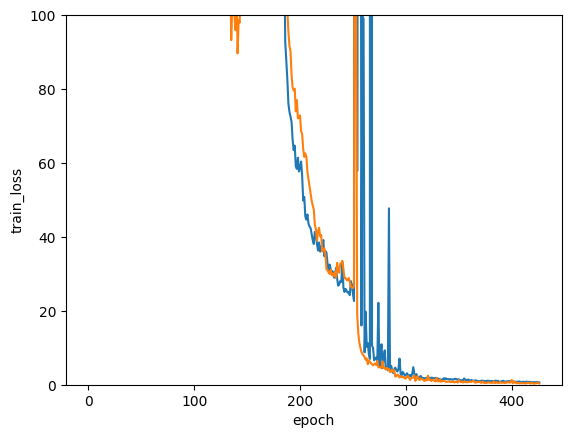

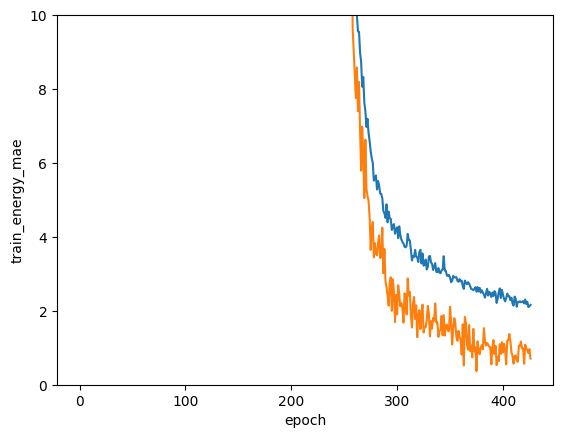

In [64]:
# df = df.sort(by="epoch")
import matplotlib.pyplot as plt
# df.plot("epoch", ["train_energy_mae", "valid_energy_mae"], style="-o")
# plt.ylim(0,100)
# plt.show()
# df.plot("epoch", ["train_forces_mae", "valid_forces_mae"])
# plt.ylim(0,10)
# plt.show()
# df.plot("epoch", ["lr_eff",])
# plt.show()
# df
import seaborn as sns

for ycol in ["train_loss", "valid_loss"]:
    sns.lineplot(base_df, x="epoch", y=ycol)
plt.ylim(0,100)
plt.show()
for ycol in ["train_energy_mae", "valid_energy_mae"]:
    sns.lineplot(base_df, x="epoch", y=ycol)
plt.ylim(0,10)
plt.show()

In [202]:
data_key, train_key = jax.random.split(
    jax.random.PRNGKey(43), 2)
NATOMS = 8
files = ["/pchem-data/meuwly/boittier/home/all2.npz"]
train_data, valid_data = prepare_datasets(data_key, 27030, 2000,
                                          files, 
                                          clip_esp=False, natoms=NATOMS, clean=False)

shape (29839, 8, 3) not failed [    0     1     2 ... 29836 29837 29838]
dataR (29839, 8, 3)
D (29839, 3)
Q 1 (29839,) 29839
Q (29839,)
R (29839, 8, 3)
(29839, 8, 3)
['R', 'Z', 'F', 'E', 'N', 'D', 'Q']
29839
0 R 29839 (29839, 8, 3)
1 Z 29839 (29839, 8)
2 F 29839 (29839, 8, 3)
3 E 29839 (29839, 1)
4 N 29839 (29839, 1)
5 D 29839 (29839, 3)
6 Q 29839 (29839,)


In [203]:
ntest = len(valid_data["E"]) // 2
print(ntest)
test_data = {k: v[ntest:] for k, v in valid_data.items()}
valid_data = {k: v[:ntest] for k, v in valid_data.items()}


1000


In [204]:
model = EF(
    # attributes
    features = 128,
    max_degree = 0,
    num_iterations = 5,
    num_basis_functions = 64,
    cutoff = 10.0,
    max_atomic_number = 12,
    charges = True,
    natoms=NATOMS,
    total_charge=0,
    n_res=4,
    zbl=True,
    # debug=["ele", "dist", "idx"],
)
model

EF(
    # attributes
    features = 128
    max_degree = 0
    num_iterations = 5
    num_basis_functions = 64
    cutoff = 10.0
    max_atomic_number = 12
    charges = True
    natoms = 8
    total_charge = 0
    n_res = 4
    zbl = True
    debug = False
)

In [205]:
import pandas as pd


data_keys = ["R", "Z", "F", "E", "D", "N", "dst_idx", "src_idx", "batch_segments"]

batch_size = 2000
test_batches = prepare_batches(data_key, test_data, batch_size,
                              num_atoms=NATOMS, 
                              data_keys=data_keys)

train_batches = prepare_batches(data_key, train_data, batch_size,
                              num_atoms=NATOMS, 
                              data_keys=data_keys)

valid_batches = prepare_batches(data_key, valid_data, batch_size,
                              num_atoms=NATOMS, 
                              data_keys=data_keys)

combined = test_batches + valid_batches + train_batches
len(combined)

13

In [ ]:
from pathlib import Path
restart_dir_base = Path("/pchem-data/meuwly/boittier/home/pycharmm_test/ckpts")
restart_dir = restart_dir_base / "cf3all-d58b8698-f2b6-4b53-bb12-337b2bf70459"
restart_dir = restart_dir_base / "cf3all-74f8f50d-f2d1-4538-8016-19905047ec58"
# restart_dir = restart_dir_base / "test-4fd66a4e-1c54-484e-a7b6-52fca8cb23d3"
restart_dir = restart_dir_base / "test-4ae608b9-b9f8-42e6-9292-4ff3841b9962"

from physnetjax.utils import get_last, get_files, get_params_model
from physnetjax.analysis import plot_stats

restart = get_last(restart_dir)
dirs = get_files(restart_dir)
# for _ in test_batches[0].keys():
#     print(_, test_batches[0][_].shape)
restart_dir = "/pchem-data/meuwly/boittier/home/pycharmm_test/ckpts/test-4ae608b9-b9f8-42e6-9292-4ff3841b9962"
restart = get_last(restart_dir)

params,model = get_params_model(restart)
# print(model)



output = plot_stats(combined, model, params, _set="Test", 
               do_kde=True, batch_size=batch_size)


/pchem-data/meuwly/boittier/home/miniforge3/envs/jaxphyscharmm/lib/python3.12/site-packages/orbax/checkpoint/type_handlers.py:1372: UserWarning: Couldn't find sharding info under RestoreArgs. Populating sharding info from sharding file. Please note restoration time will be slightly increased due to reading from file instead of directly from RestoreArgs. Note also that this option is unsafe when restoring on a different topology than the checkpoint was saved with.
  warnings.warn(


Restoring from /pchem-data/meuwly/boittier/home/pycharmm_test/ckpts/test-4ae608b9-b9f8-42e6-9292-4ff3841b9962/epoch-338
The file was last modified on: 2024-12-06 00:15:52.633440
Restored keys: dict_keys(['best_loss', 'ema_params', 'epoch', 'lr_eff', 'model', 'model_attributes', 'objectives', 'opt_state', 'params', 'transform_state'])
EF(
    # attributes
    features = 128
    max_degree = 0
    num_iterations = 5
    num_basis_functions = 64
    cutoff = 10.0
    max_atomic_number = 11
    charges = True
    natoms = 8
    total_charge = 0.0
    n_res = 3
    zbl = True
    debug = []
)


1it [00:01,  1.47s/it]

predF.shape (48000,)


2it [00:02,  1.47s/it]

predF.shape (48000,)


3it [00:04,  1.49s/it]

predF.shape (48000,)


4it [00:05,  1.48s/it]

predF.shape (48000,)


5it [00:07,  1.48s/it]

predF.shape (48000,)


6it [00:08,  1.47s/it]

predF.shape (48000,)


7it [00:10,  1.47s/it]

predF.shape (48000,)


8it [00:11,  1.47s/it]

predF.shape (48000,)


9it [00:13,  1.46s/it]

predF.shape (48000,)


10it [00:14,  1.46s/it]

predF.shape (48000,)


11it [00:16,  1.49s/it]

predF.shape (48000,)


12it [00:17,  1.48s/it]

predF.shape (48000,)


13it [00:19,  1.47s/it]

predF.shape (48000,)


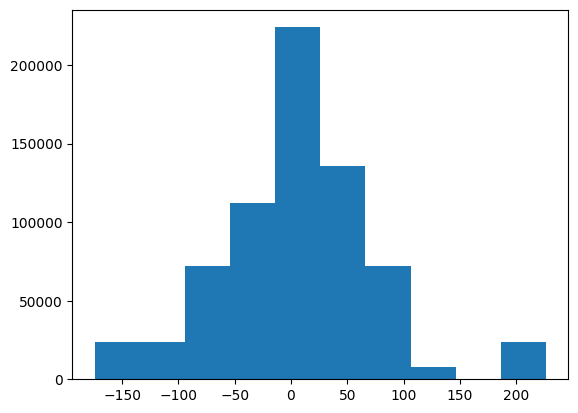

(array([  8000.,      0.,      0.,      0., 240000., 408000.,  24000.,
             0.,   8000.,   8000.]),
 array([-922.54465301, -740.14522577, -557.74579853, -375.34637129,
        -192.94694405,  -10.54751681,  171.85191043,  354.25133767,
         536.65076491,  719.05019215,  901.44961939]),
 <BarContainer object of 10 artists>)

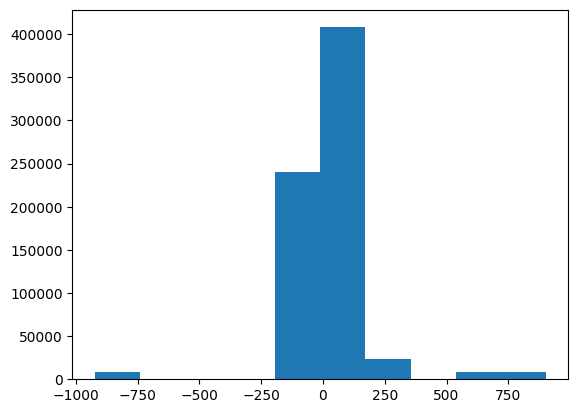

In [92]:
output["predFs"].shape[0] // 8 / 3
plt.hist(output["predFs"])
plt.show()
plt.hist(output["Fs"])

In [93]:
output.keys()

dict_keys(['Es', 'Eeles', 'predEs', 'Fs', 'predFs', 'Ds', 'predDs', 'charges', 'outputs', 'batches'])

In [94]:
import pandas as pd


data_keys = ["R", "Z", "F", "E", "D", "N", "dst_idx", "src_idx", "batch_segments"]

batch_size = 1
test_batches = prepare_batches(data_key, test_data, batch_size,
                              num_atoms=NATOMS, 
                              data_keys=data_keys)

train_batches = prepare_batches(data_key, train_data, batch_size,
                              num_atoms=NATOMS, 
                              data_keys=data_keys)

valid_batches = prepare_batches(data_key, valid_data, batch_size,
                              num_atoms=NATOMS, 
                              data_keys=data_keys)

# params = pd.read_pickle("/pchem-data/meuwly/boittier/home/pycharmm_test/checkpoints/diox-q3.2.pkl")
# for _ in test_batches[0].keys():
#     print(_, test_batches[0][_].shape)
valid_batches

[{'R': array([[ 0.48679656,  0.17337865,  0.22393374],
         [-0.67518336, -0.55696171, -0.46876354],
         [-1.0030587 , -1.67008733, -0.23185166],
         [-1.51547514,  0.26316149, -1.07705068],
         [ 1.65079414, -0.43574768,  0.171569  ],
         [ 0.68064276,  1.46282279, -0.22446149],
         [ 0.15125235,  0.36018034,  1.53103187],
         [-1.06561163,  1.07160597, -1.36305698]]),
  'Z': array([6, 6, 8, 8, 9, 9, 9, 1]),
  'F': array([[ 0.67068008,  1.67317922,  1.37408796],
         [-0.71935021,  0.99662806,  0.71128438],
         [ 0.65519639, -1.63538884,  0.30550178],
         [-0.17530828,  0.86714106, -1.16009009],
         [-0.09139484, -0.37305164, -0.18670435],
         [-0.28885106, -1.01035222, -0.47396721],
         [ 0.02117263, -0.65112276, -0.75022678],
         [-0.07214472,  0.13296712,  0.18011433]]),
  'E': array([[-36.80708512]]),
  'N': array([[8]]),
  'D': array([[ 0.12295875,  0.43656416, -0.29712848]]),
  'dst_idx': Array([0, 0, 0, 0, 0, 0

In [95]:
combined = test_batches+valid_batches + train_batches
len(combined)

29030

In [96]:
from ebc.Clustering import EBC
energies = np.array([_["E"] for _ in combined])
atomic_numbers = np.array([_["Z"] for _ in combined])

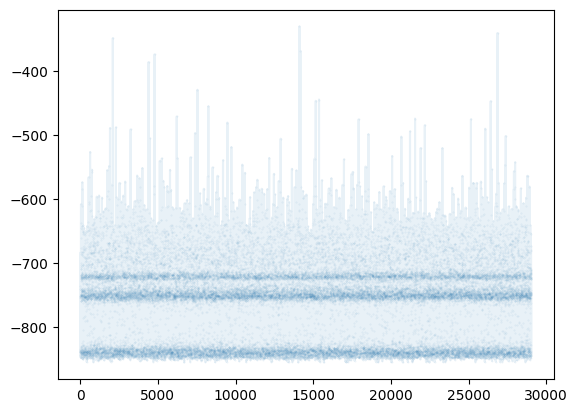

In [97]:
plt.plot(np.arange(energies.shape[0]), energies.flatten()*23, alpha=0.1)
plt.scatter(np.arange(energies.shape[0]), energies.flatten()*23, alpha=0.1, s=0.1)

In [98]:
coordinates = np.array([_["R"] for _ in combined])



In [99]:
frames =  coordinates[:,:,:] # Replace with your list of frames (arrays of Nx3 coordinates)
reference_frame = frames[0]  # First frame as the reference

aligned_frames = []
for frame in frames:
    # Center the frames around their centroid
    centered_frame = frame - frame.mean(axis=0)
    centered_reference = reference_frame - reference_frame.mean(axis=0)
    
    # Calculate the optimal rotation matrix
    R = kabsch_alignment(centered_frame, centered_reference)
    
    # Apply the rotation to align to the reference frame
    aligned_frame = np.dot(centered_frame, R)
    aligned_frames.append(aligned_frame)

aligned_frames = np.array(aligned_frames)  # Aligned list of frames

In [100]:
aligned_frames[0], aligned_frames[1]

(array([[ 0.71190088, -0.05247244,  0.30704129],
        [-0.47151061, -0.36847955, -0.66598319],
        [-0.32545867, -1.41435116, -1.25808796],
        [-1.5080623 ,  0.44030946, -0.61527008],
        [ 1.35458141,  1.00820712, -0.10862829],
        [ 0.13603355,  0.2317528 ,  1.545241  ],
        [ 1.61779978, -0.9877451 ,  0.59822583],
        [-1.51528404,  1.14277886,  0.1974614 ]]),
 array([[ 0.7348593 , -0.00230991,  0.53382492],
        [-0.56774199, -0.29928091, -0.187758  ],
        [-1.21019979, -1.26982054, -0.14860117],
        [-0.83244866,  0.79886603, -0.82756508],
        [ 0.96336101,  1.29155013,  0.79690949],
        [ 0.91420421, -0.80262059,  1.56235875],
        [ 1.68632836, -0.46432489, -0.33680681],
        [-1.68836245,  0.74794068, -1.3923621 ]]))

Using 4 components, explaining 85.6% of variance
Proto radius set to:  0.2540676824437532
Using 1002 proto clusters.
Using the eigenvector corresponding to an eigenvalue of 1.000000000000001.


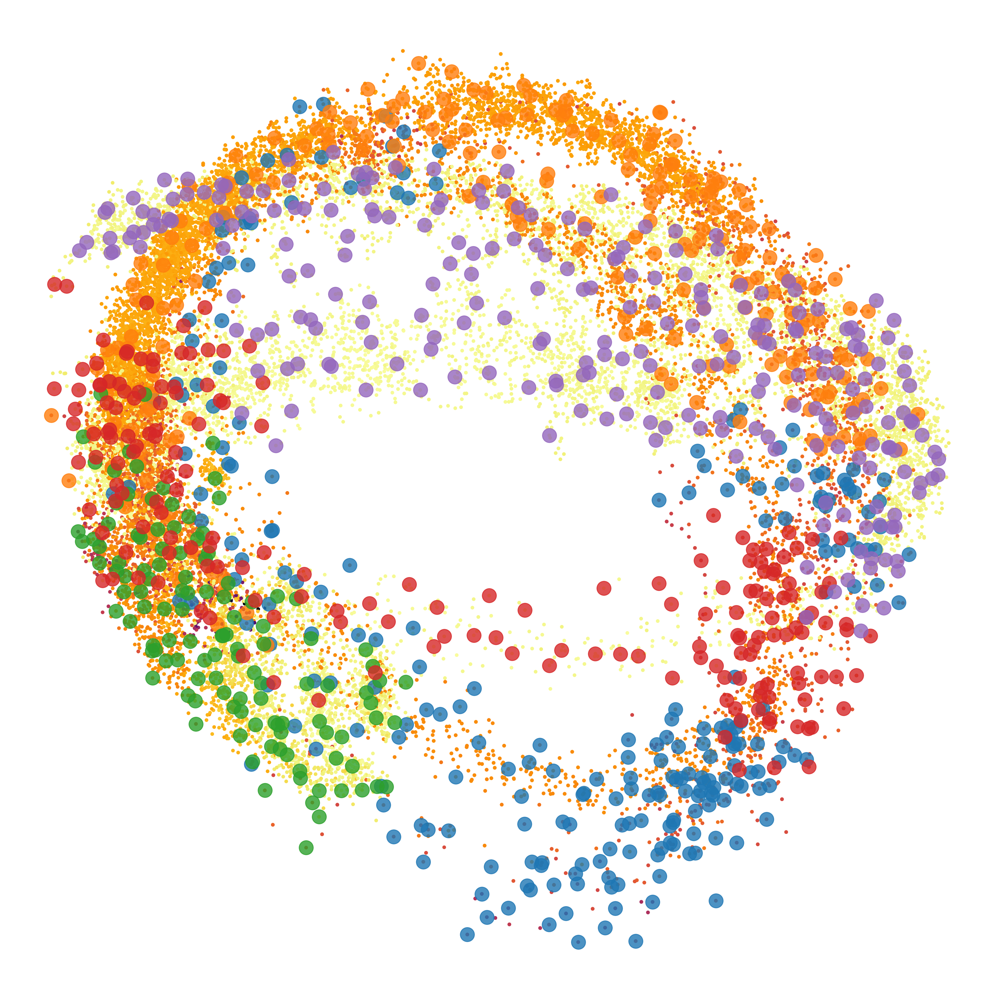

In [101]:
n = 5
ebc = EBC(n_clusters=n) 
labels = ebc.fit_transform(aligned_frames, energies)
_ = ebc.show()

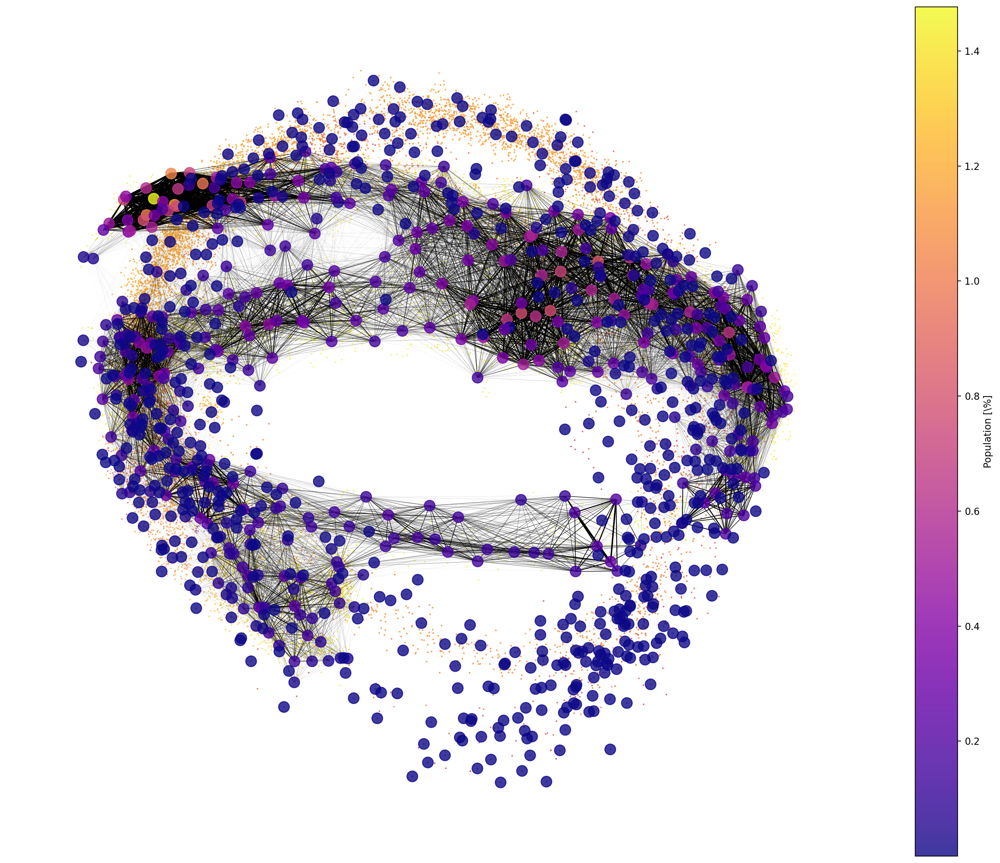

In [102]:
ebc.plot_graph()

In [103]:
species = np.unique(np.concatenate(atomic_numbers))
# Apply PCA
labels = None
soap_descr, ase_atoms = compute_soap_descriptors(coordinates, atomic_numbers, species, 
                                                 r_cut=10.0, n_max=16, l_max=5, sigma=0.5)

29030it [00:26, 1077.59it/s]


In [104]:
reduced_data_pca, model_pca = process_data(soap_descr, apply_pca, n_components=2)

Flattening descriptors...
Scaling data...
Applying apply_pca...


In [105]:
# reduced_data_tsne, model_tsne = process_data(soap_descr, apply_tsne, n_components=2, perplexity=40)


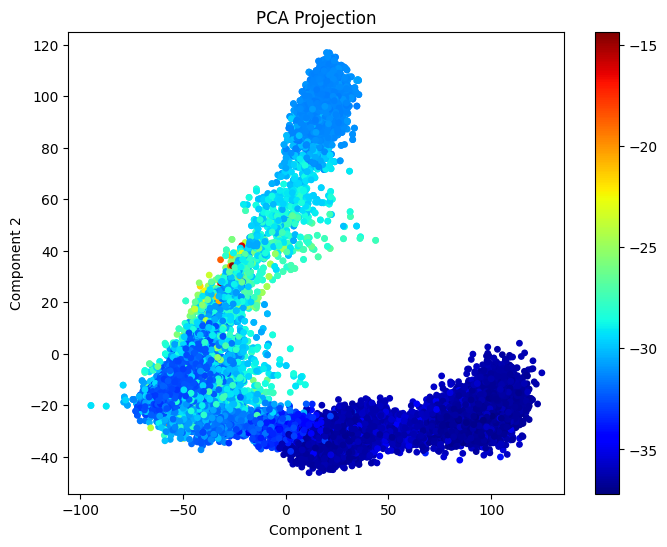

In [106]:
visualize_projection(reduced_data_pca, labels, title="PCA Projection", c=energies)

In [184]:
errors = abs(output["Es"].flatten() - output["predEs"].flatten())
visualize_projection(reduced_data_pca[:-30,:], None, title="PCA Projection", c=errors)
plt.colorbar()

TypeError: visualize_projection() got an unexpected keyword argument 's'

In [112]:
# visualize_projection(reduced_data_tsne, labels, title="t-SNE Projection", c=energies)

Using 125 components, explaining 99.9% of variance
Proto radius set to:  0.1589636430880833
Using 2958 proto clusters.
The gap between the two largest eigenvalues is 1.7110199694858608e-06.
Your graph might consist of multiple disconnected components which can result in unexpected behaviour.
Consider increasing the number of knn and/or the temperature.
Using the eigenvector corresponding to an eigenvalue of 0.9999999999983816.


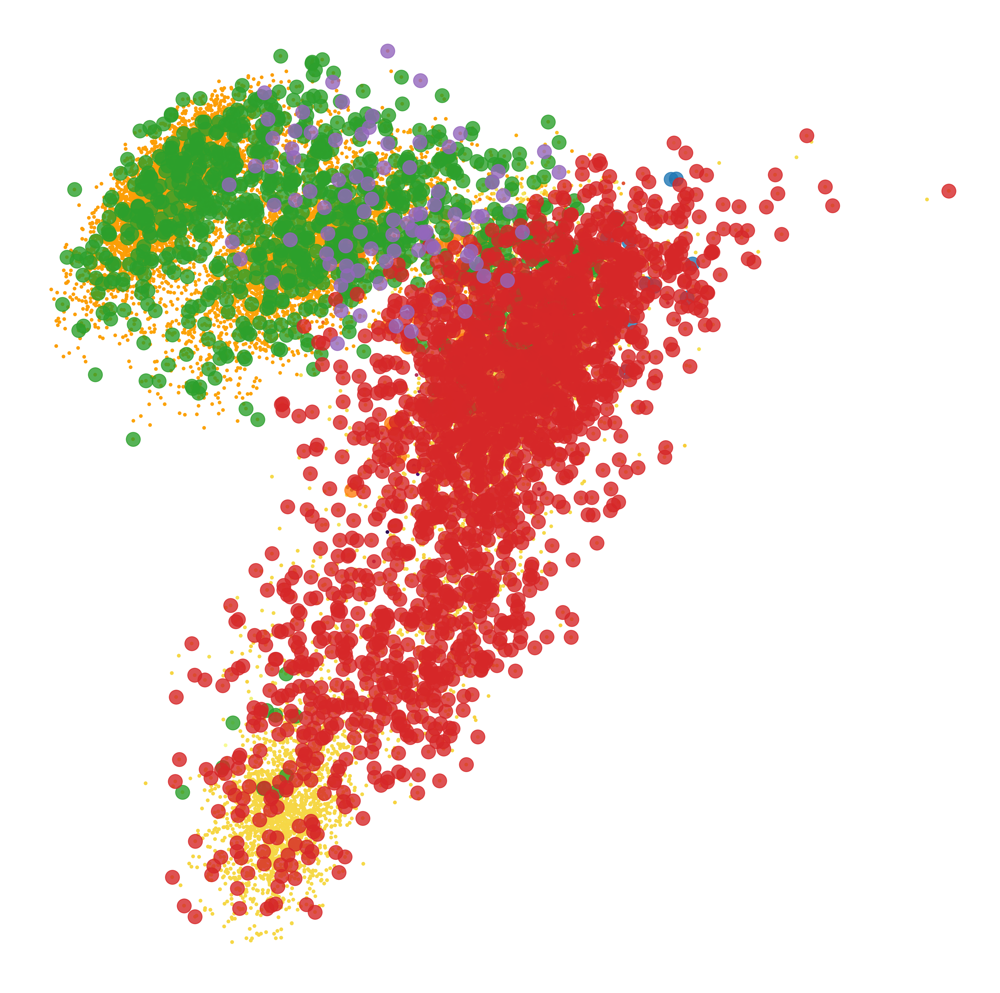

In [113]:
n = 5
ebc = EBC(n_clusters=n) 
labels = ebc.fit_transform(soap_descr[:-30,:], errors)
_ = ebc.show()

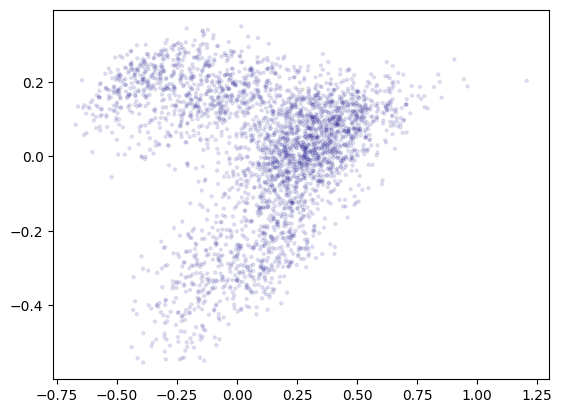

In [115]:
plt.scatter(ebc._proto_2D[:, 0], ebc._proto_2D[:, 1], c=ebc.pi * 100,
            s=5, cmap=plt.cm.plasma, zorder=100, alpha=0.1)


In [116]:
import numpy as np
from pathlib import Path
import os
import shutil
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from ase import Atoms
from ase.visualize.plot import plot_atoms
from io import BytesIO
import numpy as np
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from ase import io
from ase.io.pov import get_bondpairs
from ase.data import covalent_radii

default_color_dict = {
    'Cl': [102, 227, 115],
    'C': [61, 61, 64],
    'O': [240, 10, 10],
    "F": [0,232,0],
    'H': [232, 206, 202],
    'K': [128, 50, 100],
    'X': [200, 200, 200]
}



def render_povray(atoms, pov_name,
                  rotation='0x, 0y, 0z',
                  radius_scale=0.40, color_dict=None):
    print("Rendering POV-Ray image...")
    print("path: ", pov_name)
    if color_dict is None:
        color_dict = default_color_dict

    path = Path(pov_name)
    pov_name = path.name
    base = path.parent

    radius_list = []
    for atomic_number in atoms.get_atomic_numbers():
        radius_list.append(radius_scale * covalent_radii[atomic_number])

    colors = np.array([color_dict[atom.symbol] for atom in atoms]) / 255

    bondpairs = get_bondpairs(atoms, radius=1.1)
    good_bonds = []
    for _ in bondpairs:
        #  remove the Cl-Cl bonds
        if not (atoms[_[0]].symbol == "Cl" and atoms[_[1]].symbol == "Cl"):
            good_bonds.append(_)

    kwargs = {  # For povray files only
        'transparent': True,  # Transparent background
        'canvas_width': 1028,  # Width of canvas in pixels
        'canvas_height': None,  # None,  # Height of canvas in pixels
        'camera_dist': 50.0,  # Distance from camera to front atom,
        'camera_type': 'orthographic angle 0',  # 'perspective angle 20'
        'depth_cueing': False,
        'colors': colors,
        'bondatoms': good_bonds,
        "textures": ["jmol"] * len(atoms),
    }

    generic_projection_settings = {
        'rotation': rotation,
        'radii': radius_list,
    }

    povobj = io.write(
        pov_name,
        atoms,
        **generic_projection_settings,
        povray_settings=kwargs)

    povobj.render(povray_executable='/pchem-data/meuwly/boittier/home/miniforge3/envs/jaxphyscharmm/bin/povray')
    png_name = pov_name.replace(".pov", ".png")
    shutil.move(png_name, base / png_name)
    return png_name

In [149]:
soap_descr.shape

(29030, 12480)

Using 125 components, explaining 99.9% of variance
Proto radius set to:  0.16404700762124266
Using 2592 proto clusters.
Using the eigenvector corresponding to an eigenvalue of 0.999999999999998.


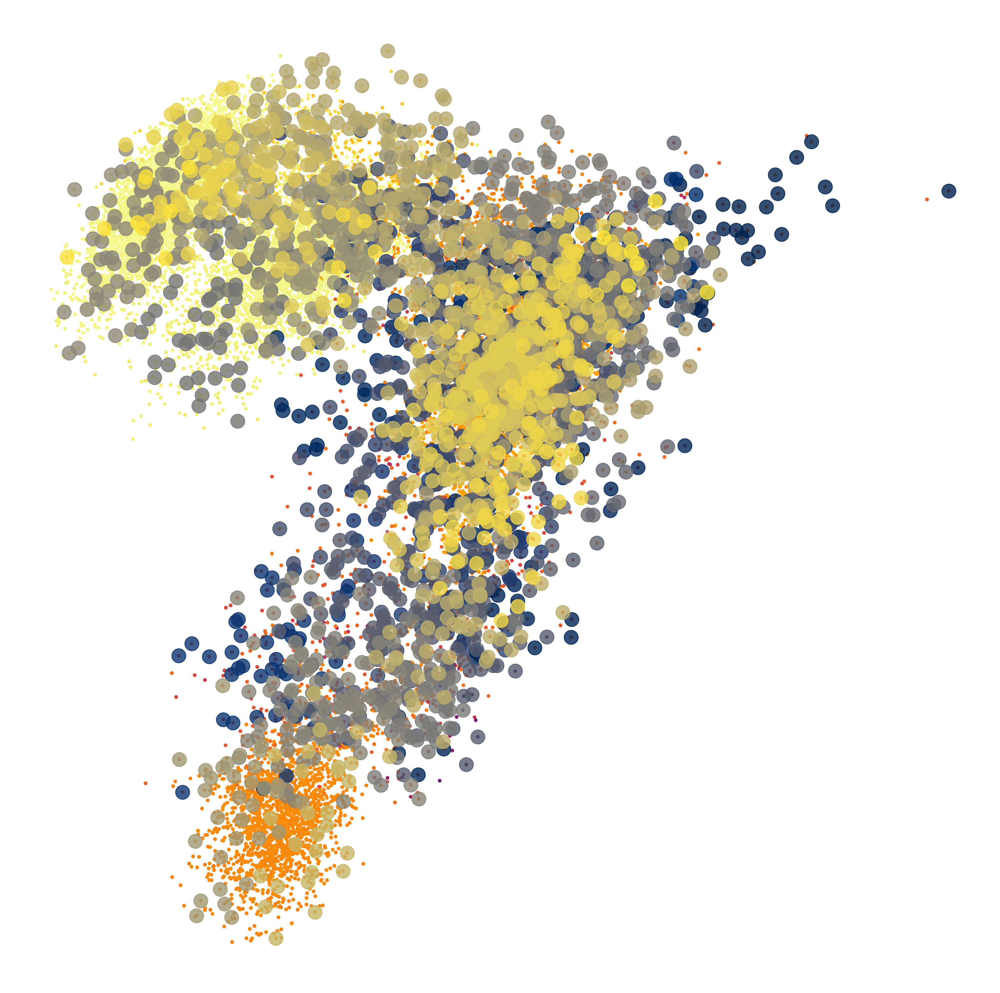

In [188]:
n = 50
ebc = EBC(n_clusters=n, temperature=100) 
labels = ebc.fit_transform(soap_descr[:-30,:], output["Es"])
_ = ebc.show()

In [ ]:
ebc.plot_graph()

In [ ]:
_ = ebc.hierarchical()

In [ ]:
errors = abs(output["Es"].flatten() - output["predEs"].flatten())
print(errors.shape,ebc._proto_2D.shape )

cluster_members_energy = {_:float(errors[_]) for _ in range(int(ebc._proto_2D.shape[0]))}

# plt.scatter(ebc._proto_2D[:, 0], ebc._proto_2D[:, 1], alpha=0.1, c=errors, zorder=-1)
s = plt.scatter(ebc._proto_2D[:, 0][::], ebc._proto_2D[:, 1][::], alpha=1, c=[cluster_members_energy[_]
                for _ in range(int(ebc._proto_2D.shape[0]))], 
                vmin=30, vmax=100, zorder=-1, cmap="jet",s=10)
plt.colorbar(s)
plt.show()

In [ ]:
fig, ax = plt.subplots()

for idk, cluster_key in enumerate(ebc._cluster_ids[:]):
    cluster_members = ebc.get_cluster_members(cluster_key)
    coords = ebc._proto_2D[cluster_members]
    ccolor = ebc.cluster_colormap[idk]
    # plt.title(f"Cluster {cluster_key+1}", color=ccolor)
    
    ax.scatter(coords[:, 0], coords[:, 1], s=10, c=ccolor)
    # ax.scatter(ebc._proto_2D[::, 0], ebc._proto_2D[::, 1], alpha=0.1, color="gray", zorder=-1)
    ax.set_xlim(-range_/2,range_/2)
    ax.set_ylim(-range_/2,range_/2)

In [ ]:
range_ = max(max(ebc._proto_2D[:, 0].flatten()), 
            max(ebc._proto_2D[:, 1].flatten())) - min(min(ebc._proto_2D[:, 0].flatten()), 
                 min(ebc._proto_2D[:, 1].flatten())) 
range_*=1.5

for idk, cluster_key in enumerate(ebc._cluster_ids[:]):
    cluster_members = ebc.get_cluster_members(cluster_key)
    coords = ebc._proto_2D[cluster_members]
    ccolor = ebc.cluster_colormap[idk]
    fig, ax = plt.subplots()
    plt.title(f"Cluster {cluster_key+1}", color=ccolor)
    
    ax.scatter(coords[:, 0], coords[:, 1], c=errors[cluster_members], s=1, cmap="jet", vmin=0, vmax=100)
    ax.scatter(ebc._proto_2D[::, 0], ebc._proto_2D[::, 1], alpha=0.01, color="gray", zorder=-1)
    ax.set_xlim(-range_/1.2,range_/1.2)
    ax.set_ylim(-range_/1.2,range_/1.2)
    
    
    plot_coords = np.array([[0.2,0.2], [0.2,0.8], [0.8,0.8], [0.8,0.2]])    

    cluster_members_energy = {_:float(errors[_]) for _ in cluster_members[0]}
    cm = list(cluster_members[0].copy())
    cm.sort(key=lambda x: -cluster_members_energy[x])
    
    for idx, i in enumerate(cm[:4]):
        print(idk, cluster_key, idx, i, cluster_members_energy[i])
        # Use OffsetImage to embed the image into the PCA plot
        png_name = render_povray(ase_atoms[i], f"test-{i}-{idx}-{idk}-{cluster_key}.pov")
        image = plt.imread(f"test-{i}-{idx}-{idk}-{cluster_key}.png")
        offset_image = OffsetImage(image, zoom=0.1)
        annotation = AnnotationBbox(offset_image, (plot_coords[idx][0], plot_coords[idx][1]), frameon=False,
                                               boxcoords=ax.transAxes, 
                                    zorder=10,# Relative to the axes of the plot
)
        ax.add_artist(annotation)

        plot_coords[idx] = plot_coords[idx] * range_ - range_/2
        data_points = [ebc._proto_2D[i][0], ebc._proto_2D[i][1] ]        
        linexs = np.array([plot_coords[idx][0], data_points[0]]).flatten()
        lineys = np.array([plot_coords[idx][1], data_points[1]]).flatten()
        
        print(linexs, lineys)
        
        ax.plot(linexs, lineys, "--", color="k")
        
        del image
    plt.show()
    plt.clf()